In [1]:
import os
import librosa
import matplotlib.pyplot as plt
import tensorflow as tf
import numpy as np
from tensorflow.keras.layers import Conv2D,MaxPool2D,Flatten,Dense,Dropout
from tensorflow.keras.optimizers import Adam

In [ ]:
random_file_name = "/content/drive/MyDrive/deep_audio_classification/blues.00000.wav"

# visualizing single audio

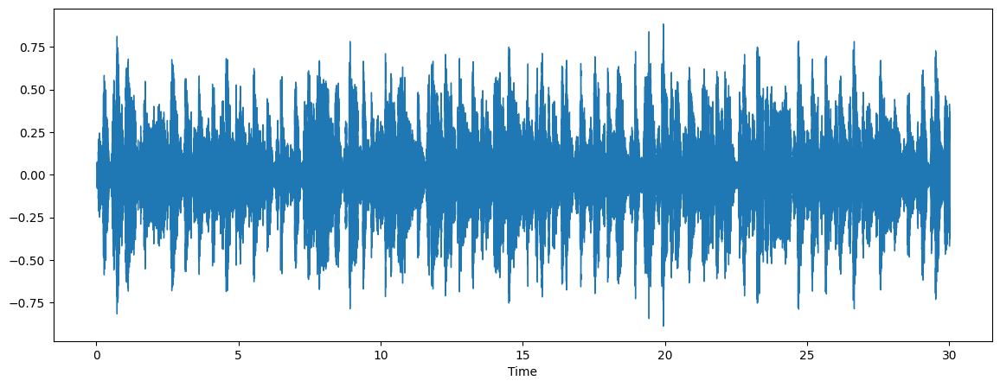

In [ ]:
y,sr = librosa.load(random_file_name,sr=44100)
plt.figure(figsize=(14,5))
librosa.display.waveshow(y,sr=sr)

In [ ]:
y.shape

(1323588,)

In [ ]:
from IPython.display import Audio
Audio(data=y,rate=sr)

In [ ]:
y

array([ 0.00734921,  0.01335782,  0.01657648, ..., -0.07293833,
       -0.06308185, -0.03151622], dtype=float32)

# visualization on chunks of audio

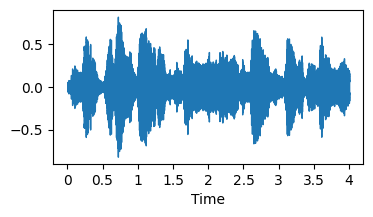

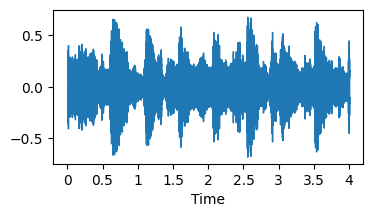

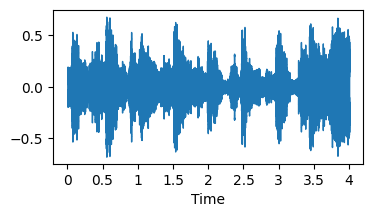

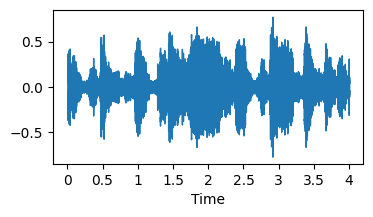

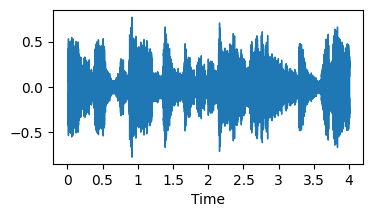

...

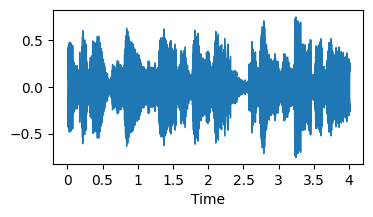

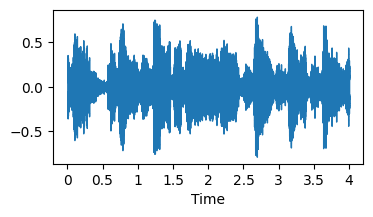

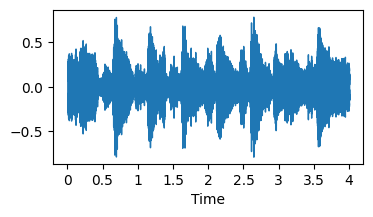

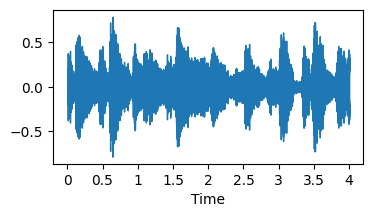

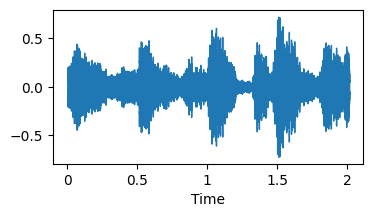

In [ ]:
audio_path = "/content/drive/MyDrive/deep_audio_classification/blues.00000.wav"
y, sr = librosa.load(audio_path, sr=None)  # sr=None to keep the original sampling rate

# Define the duration of each chunk and overlap
chunk_duration = 4  # seconds
overlap_duration = 2  # seconds

# Convert durations to samples
chunk_samples = chunk_duration * sr
overlap_samples = overlap_duration * sr

# Calculate the number of chunks
num_chunks = int(np.ceil((len(y) - chunk_samples) / (chunk_samples - overlap_samples))) + 1

# Iterate over each chunk
for i in range(num_chunks):
    # Calculate start and end indices of the chunk
    start = i * (chunk_samples - overlap_samples)
    end = start + chunk_samples

    # Extract the chunk of audio
    chunk = y[start:end]
    plt.figure(figsize=(4, 2))
    librosa.display.waveshow(chunk, sr=sr)
    plt.show()

# melspectogram visualization

In [ ]:
#Plotting Melspectrogram of Entire Audio
def plot_melespectrogram(y,sr):
    #Compute spectrogram
    spectrogram = librosa.feature.melspectrogram(y=y,sr=sr)
    #Convert to decibels (log scale)
    spectrogram_db = librosa.power_to_db(spectrogram,ref=np.max)
    #Visualize the spectrogram
    plt.figure(figsize=(10,4))
    librosa.display.specshow(spectrogram_db,sr=sr,x_axis='time',y_axis='mel')
    plt.colorbar(format='%2.0f dB')
    plt.title("Spectrogram")
    plt.tight_layout()
    plt.show()

In [ ]:
random_file_name = "/content/drive/MyDrive/deep_audio_classification/blues.00000.wav"
y,sr = librosa.load(random_file_name,sr=44100)


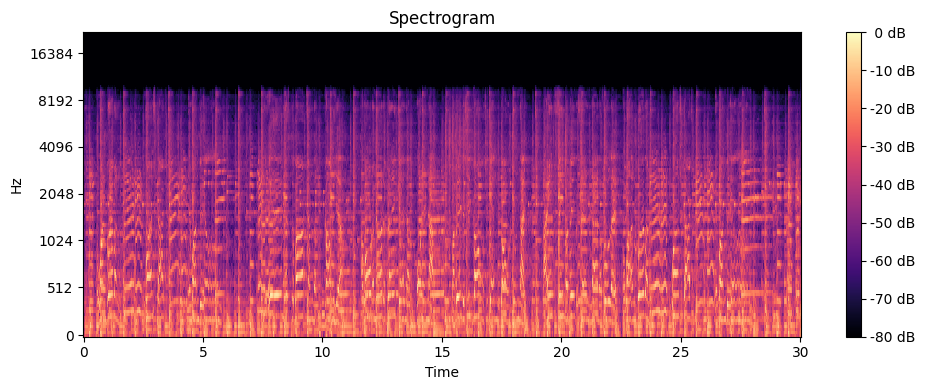

In [ ]:
plot_melespectrogram(y,sr)

In [ ]:
def plot_melspectrogram_chunks(y,sr):
    #define the duration of each chunk and overlap
    chunk_duration = 4
    overlap_duration = 2

    #Convert duration to sample
    chunk_samples = chunk_duration * sr
    overlap_samples = overlap_duration * sr

    #Calculate the number of chunks
    num_chunks = int(np.ceil((len(y)-chunk_samples)/(chunk_samples-overlap_samples)))+1

    #iterate over each chunks
    for i in range(num_chunks):
        #Calculate start and end indices of the chunk
        start = i*(chunk_samples-overlap_samples)
        end = start+chunk_samples
        #Extract the chunk audio
        chunk = y[start:end]
        #Melspectrogram part
        spectrogram = librosa.feature.melspectrogram(y=chunk,sr=sr)
        print(spectrogram.shape)
        spectrogram_db = librosa.power_to_db(spectrogram,ref=np.max)
        #Visualize the spectrogram
        plt.figure(figsize=(10,4))
        librosa.display.specshow(spectrogram_db,sr=sr,x_axis='time',y_axis='mel')
        plt.colorbar(format='%2.0f dB')
        plt.title("Spectrogram")
        plt.tight_layout()
        plt.show()

In [ ]:
random_file_name = "/content/drive/MyDrive/deep_audio_classification/blues.00000.wav"
y,sr = librosa.load(random_file_name,sr=44100)


(128, 345)


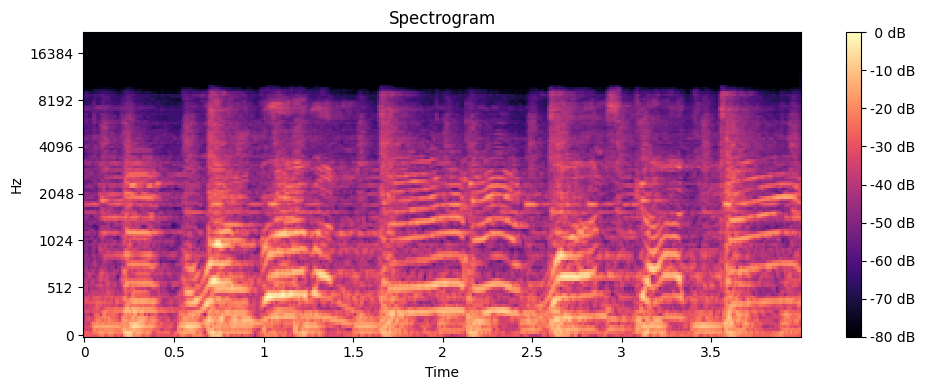

(128, 345)


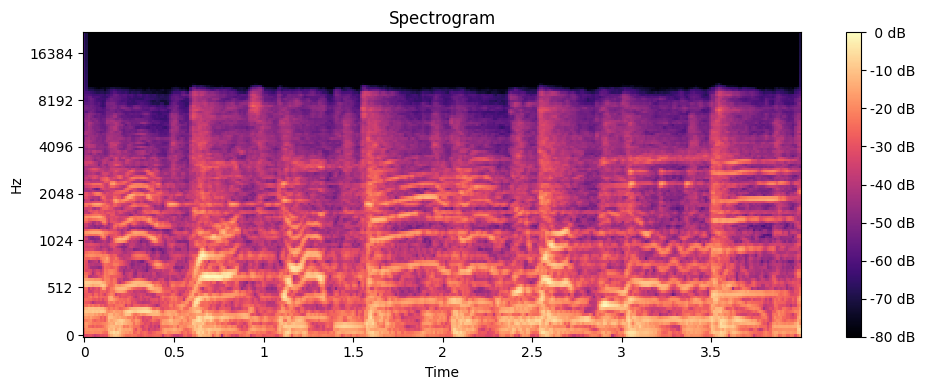

(128, 345)


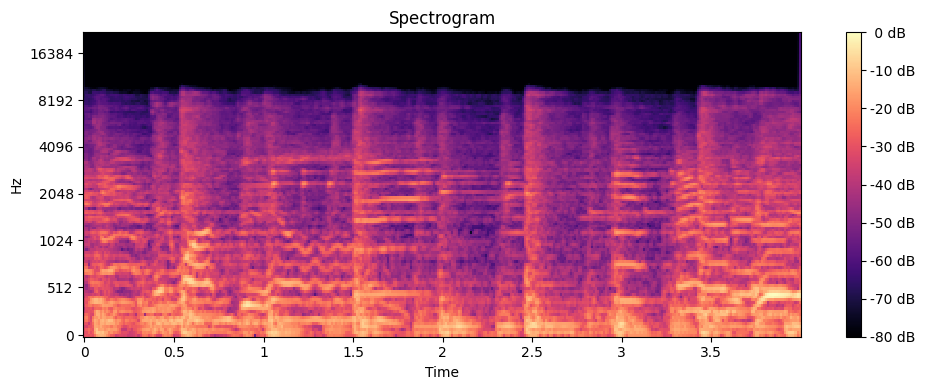

(128, 345)


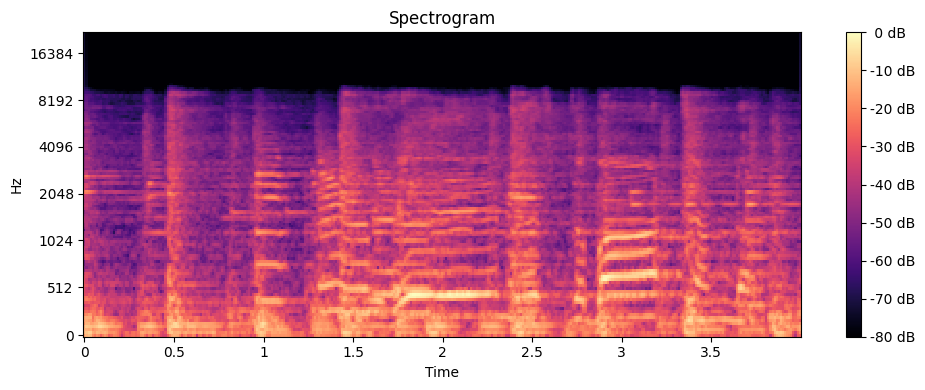

(128, 345)


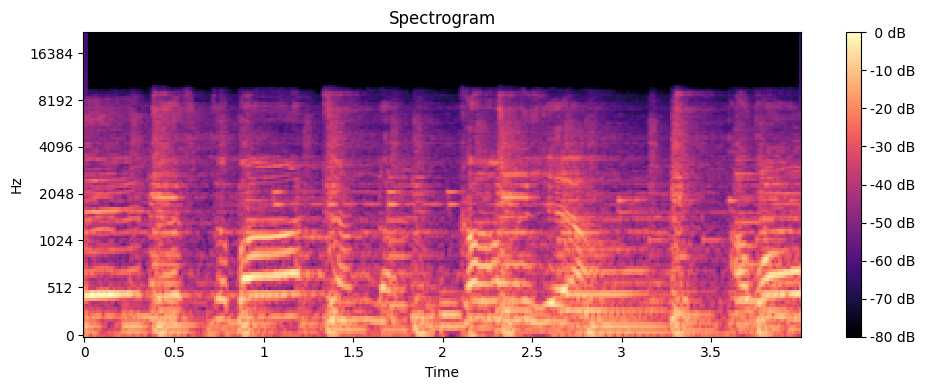

(128, 345)


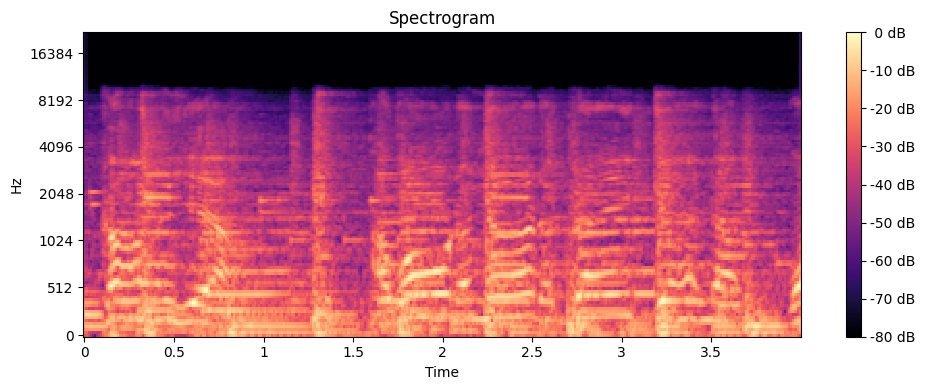

(128, 345)


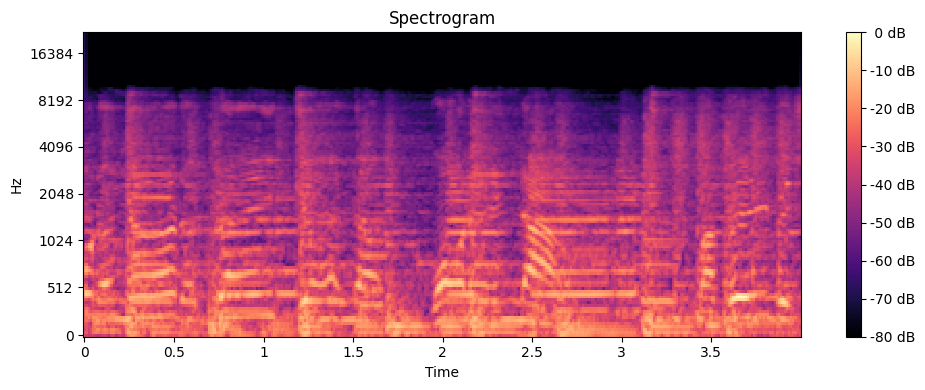

(128, 345)


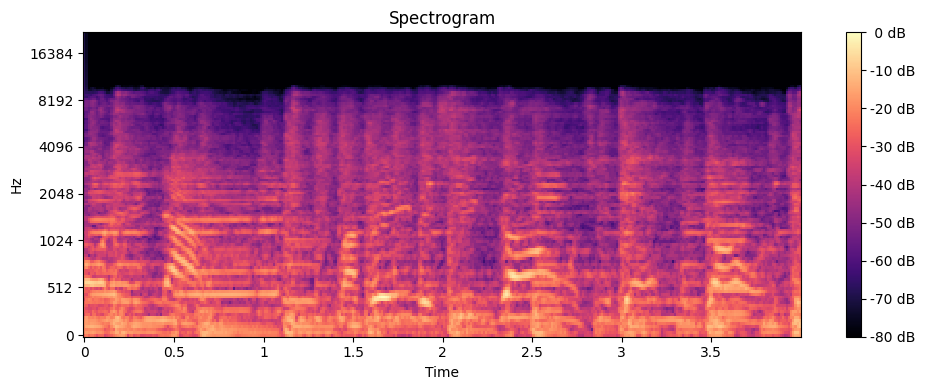

(128, 345)


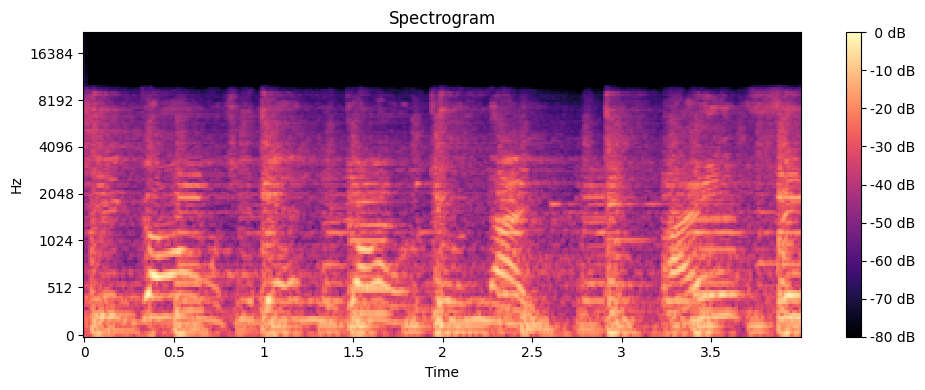

(128, 345)


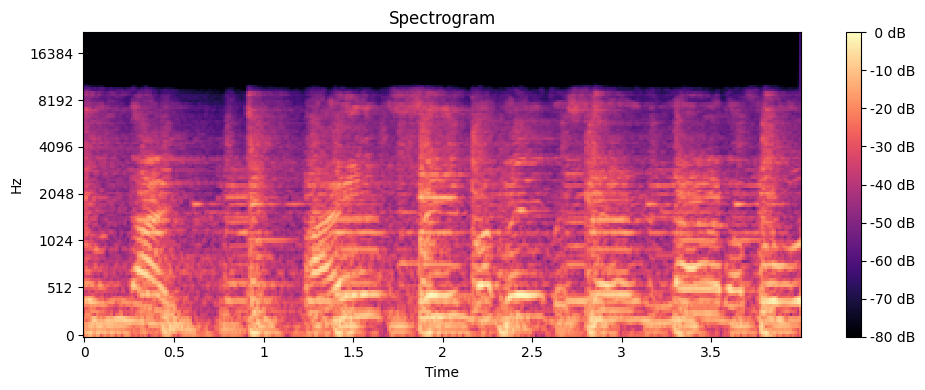

(128, 345)


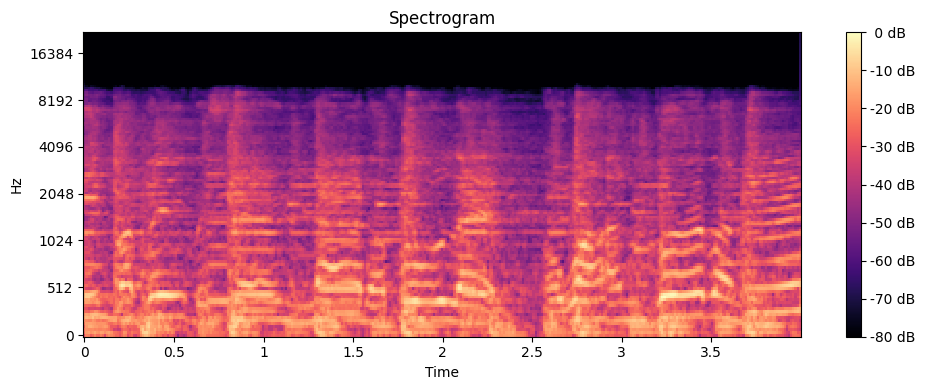

(128, 345)


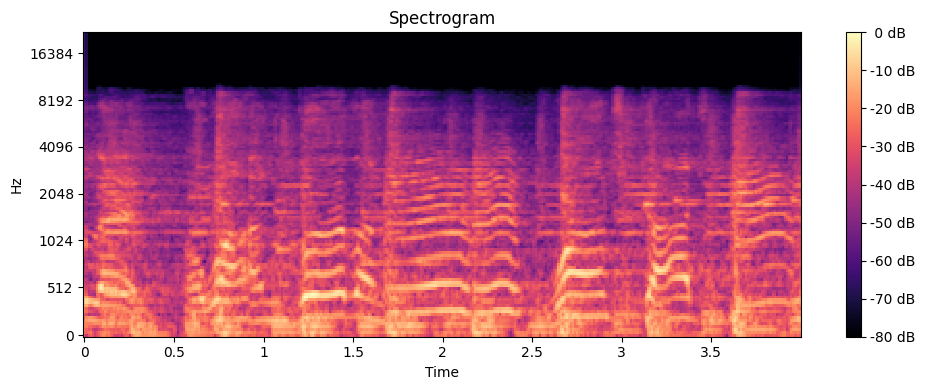

(128, 345)


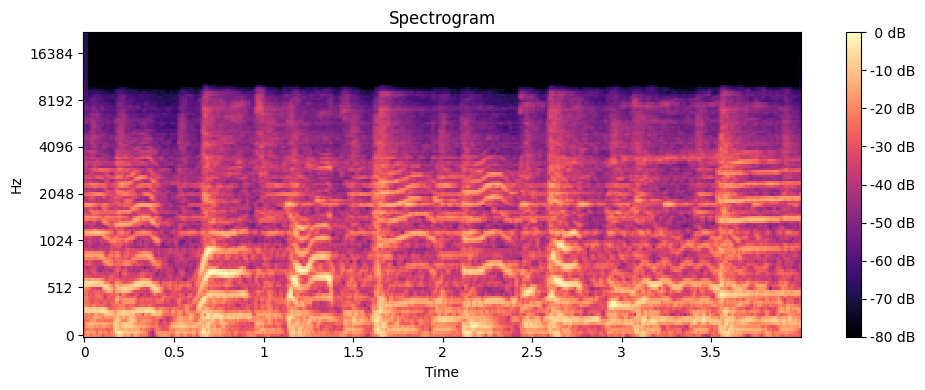

(128, 345)


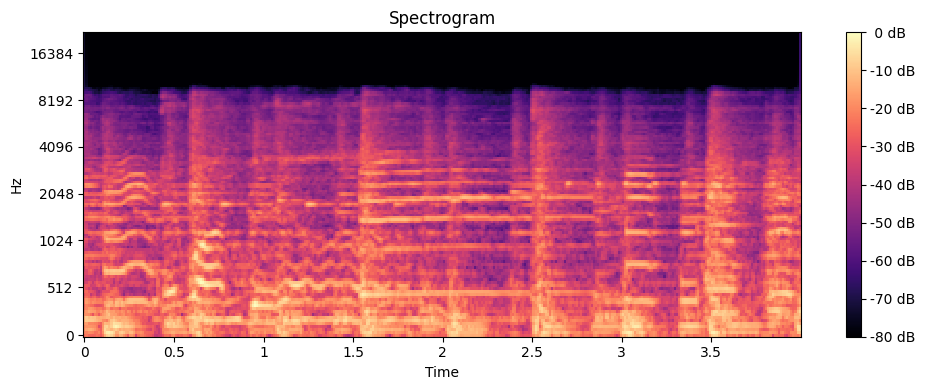

(128, 174)


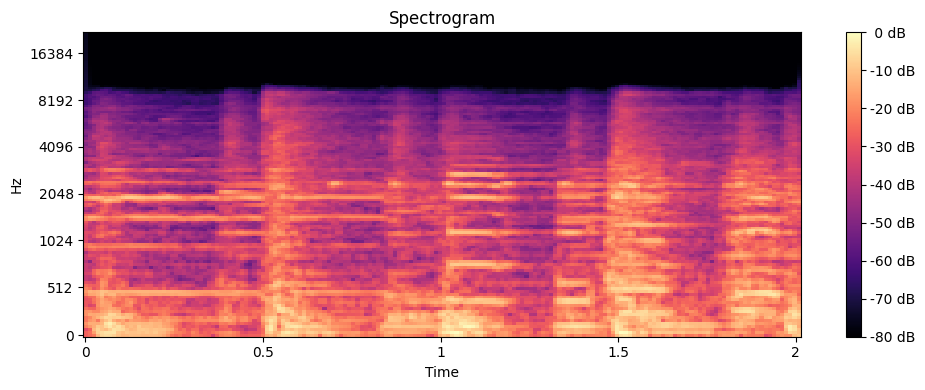

In [ ]:
plot_melspectrogram_chunks(y,sr)

# **NEURAL NETWORK PROJECT**

---


---



# data preprocessing for model

In [2]:
#define your folder structure
data_dir = "/content/drive/MyDrive/deep_audio_classification/genres_original"
classes = ['blues', 'classical','country','disco','hiphop','jazz','metal','pop','reggae','rock']


In [3]:
from tensorflow.image import resize
#Load and preprocess audio data
def load_and_preprocess_data(data_dir,classes,target_shape=(210,210)):
    data=[]
    labels=[]

    for i_class,class_name in enumerate(classes):
        class_dir = os.path.join(data_dir,class_name)
        print("Processing--",class_name)
        for filename in os.listdir(class_dir):
            if filename.endswith('.wav'):
                file_path = os.path.join(class_dir,filename)
                audio_data,sample_rate = librosa.load(file_path,sr=None)
                #Performing Preprocessing
                #define the duration of each chunk and overlap
                chunk_duration = 4
                overlap_duration = 2

                #Convert duration to sample
                chunk_samples = chunk_duration * sample_rate
                overlap_samples = overlap_duration * sample_rate

                #Calculate the number of chunks
                num_chunks = int(np.ceil((len(audio_data)-chunk_samples)/(chunk_samples-overlap_samples)))+1

                #iterate over each chunks
                for i in range(num_chunks):
                    #Calculate start and end indices of the chunk
                    start = i*(chunk_samples-overlap_samples)
                    end = start+chunk_samples
                    #Extract the chunk audio
                    chunk = audio_data[start:end]
                    #Melspectrogram part
                    mel_spectrogram = librosa.feature.melspectrogram(y=chunk,sr=sample_rate)
                    #Resize matrix based on provided target shape
                    mel_spectrogram = resize(np.expand_dims(mel_spectrogram,axis=-1),target_shape)
                    #Append data to list
                    data.append(mel_spectrogram)
                    labels.append(i_class)
    #Return
    return np.array(data),np.array(labels)

In [4]:
data,labels = load_and_preprocess_data(data_dir,classes)

Processing-- blues
Processing-- classical
Processing-- country
Processing-- disco
Processing-- hiphop
Processing-- jazz
Processing-- metal
Processing-- pop
Processing-- reggae
Processing-- rock


In [5]:
from tensorflow.keras.utils import to_categorical
labels = to_categorical(labels,num_classes = len(classes)) # Converting labels to one-hot encoding
labels

array([[1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       [1., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 1.],
       [0., 0., 0., ..., 0., 0., 1.],
       [0., 0., 0., ..., 0., 0., 1.]])

# Splitting of Dataset into Training and Test set

In [6]:
from sklearn.model_selection import train_test_split
X_train,X_test,Y_train,Y_test = train_test_split(data,labels,test_size=0.2,random_state=42)

In [7]:
X_train.shape

(11980, 210, 210, 1)

In [8]:
X_test.shape

(2995, 210, 210, 1)

In [9]:
Y_train.shape

(11980, 10)

# Building Model




     



In [10]:
model = tf.keras.models.Sequential()

In [11]:
X_train[0].shape

(210, 210, 1)

In [12]:
model.add(Conv2D(filters=32,kernel_size=3,padding='same',activation='relu',input_shape=X_train[0].shape))
model.add(Conv2D(filters=32,kernel_size=3,activation='relu'))
model.add(MaxPool2D(pool_size=2,strides=2))

/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [13]:
model.add(Conv2D(filters=64,kernel_size=3,padding='same',activation='relu'))
model.add(Conv2D(filters=64,kernel_size=3,activation='relu'))
model.add(MaxPool2D(pool_size=2,strides=2))

In [14]:
model.add(Conv2D(filters=128,kernel_size=3,padding='same',activation='relu'))
model.add(Conv2D(filters=128,kernel_size=3,activation='relu'))
model.add(MaxPool2D(pool_size=2,strides=2))


In [15]:
model.add(Dropout(0.3))


In [16]:
model.add(Conv2D(filters=256,kernel_size=3,padding='same',activation='relu'))
model.add(Conv2D(filters=256,kernel_size=3,activation='relu'))
model.add(MaxPool2D(pool_size=2,strides=2))

In [17]:
model.add(Conv2D(filters=512,kernel_size=3,padding='same',activation='relu'))
model.add(Conv2D(filters=512,kernel_size=3,activation='relu'))
model.add(MaxPool2D(pool_size=2,strides=2))

In [18]:
model.add(Dropout(0.3))

In [19]:
model.add(Flatten())

In [20]:
model.add(Dense(units=1200,activation='relu'))

In [21]:
model.add(Dropout(0.45))

In [22]:
#Output layer
model.add(Dense(units=len(classes),activation='softmax'))

In [23]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 210, 210, 32)   │           320 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 208, 208, 32)   │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 104, 104, 32)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 104, 104, 64)   │        18,496 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 102, 102, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 51, 51, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 51, 51, 128)    │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 49, 49, 128)    │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_2 (MaxPooling2D)  │ (None, 24, 24, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 24, 24, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_6 (Conv2D)               │ (None, 24, 24, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_7 (Conv2D)               │ (None, 22, 22, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_3 (MaxPooling2D)  │ (None, 11, 11, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_8 (Conv2D)               │ (None, 11, 11, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_9 (Conv2D)               │ (None, 9, 9, 512)      │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_4 (MaxPooling2D)  │ (None, 4, 4, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_1 (Dropout)             │ (None, 4, 4, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 1200)           │     9,831,600 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_2 (Dropout)             │ (None, 1200)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 10)             │        12,010 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 14,555,258 (55.52 MB)

 Trainable params: 14,555,258 (55.52 MB)

 Non-trainable params: 0 (0.00 B)

In [24]:
#Compile the model
model.compile(optimizer=Adam(learning_rate=0.0001),loss='categorical_crossentropy',metrics=['accuracy'])

In [25]:
#Training Model
training_history = model.fit(X_train,Y_train,epochs=30,batch_size=32,validation_data=(X_test,Y_test))


Epoch 1/30
375/375 ━━━━━━━━━━━━━━━━━━━━ 95s 194ms/step - accuracy: 0.2273 - loss: 2.0742 - val_accuracy: 0.4694 - val_loss: 1.5054
Epoch 2/30
375/375 ━━━━━━━━━━━━━━━━━━━━ 107s 150ms/step - accuracy: 0.4964 - loss: 1.4251 - val_accuracy: 0.6110 - val_loss: 1.1159
Epoch 3/30
375/375 ━━━━━━━━━━━━━━━━━━━━ 82s 149ms/step - accuracy: 0.6147 - loss: 1.1074 - val_accuracy: 0.6694 - val_loss: 0.9715
Epoch 4/30
375/375 ━━━━━━━━━━━━━━━━━━━━ 54s 143ms/step - accuracy: 0.6967 - loss: 0.8821 - val_accuracy: 0.7366 - val_loss: 0.7799
Epoch 5/30
375/375 ━━━━━━━━━━━━━━━━━━━━ 83s 146ms/step - accuracy: 0.7638 - loss: 0.6951 - val_accuracy: 0.7826 - val_loss: 0.6628
Epoch 6/30
375/375 ━━━━━━━━━━━━━━━━━━━━ 82s 145ms/step - accuracy: 0.8036 - loss: 0.5761 - val_accuracy: 0.8177 - val_loss: 0.5403
Epoch 7/30
375/375 ━━━━━━━━━━━━━━━━━━━━ 82s 145ms/step - accuracy: 0.8381 - loss: 0.4771 - val_accuracy: 0.8257 - val_loss: 0.5096
Epoch 8/30
375/375 ━━━━━━━━━━━━━━━━━━━━ 82s 145ms/step - accuracy: 0.8684 - loss: 

In [26]:
model.save("/content/drive/MyDrive/deep_audio_classification/Trained_model.keras")

In [31]:
# to reload model
# model=tf.keras.models.load_model("trainedmoel path")
#model.summary()

In [27]:
training_history.history

{'accuracy': [0.31385642290115356,
  0.5364774465560913,
  0.6388146877288818,
  0.7090985178947449,
  0.7686978578567505,
  0.8070951700210571,
  0.8406510949134827,
  0.8684474229812622,
  0.8953255414962769,
  0.9101836681365967,
  0.9266276955604553,
  0.9330551028251648,
  0.9469950199127197,
  0.9520868062973022,
  0.9618530869483948,
  0.9631052017211914,
  0.9690316915512085,
  0.969699501991272,
  0.9716193675994873,
  0.9757094979286194,
  0.9763773083686829,
  0.9791318774223328,
  0.9813021421432495,
  0.9823038578033447,
  0.9823038578033447,
  0.9809682965278625,
  0.9873121976852417,
  0.9879799485206604,
  0.9801335334777832,
  0.9862270355224609],
 'loss': [1.865699291229248,
  1.3323304653167725,
  1.0430834293365479,
  0.8515722155570984,
  0.6769289374351501,
  0.5661839842796326,
  0.4621398150920868,
  0.38261932134628296,
  0.3048890233039856,
  0.2672273516654968,
  0.21191897988319397,
  0.1952509731054306,
  0.15098200738430023,
  0.14240366220474243,
  0.1157

In [29]:
import json
with open('training_hist.json','w')as f:
  json.dump(training_history.history,f)

In [30]:
#Reloading Training history
import json
with open("training_hist.json",'r') as json_file:
    training_history_data = json.load(json_file)




training_history_data.keys()

dict_keys(['accuracy', 'loss', 'val_accuracy', 'val_loss'])

# model evaluation

In [32]:
#Model evaluation on Training set
train_loss,train_accuracy = model.evaluate(X_train,Y_train)

375/375 ━━━━━━━━━━━━━━━━━━━━ 19s 49ms/step - accuracy: 0.9970 - loss: 0.0095


In [33]:
train_loss,train_accuracy

(0.009808703325688839, 0.9966611266136169)

In [34]:
#Model evaluation on Validation set
val_loss,val_accuracy = model.evaluate(X_test,Y_test)

94/94 ━━━━━━━━━━━━━━━━━━━━ 4s 41ms/step - accuracy: 0.9368 - loss: 0.2184


In [35]:
val_loss,val_accuracy

(0.2228344827890396, 0.936227023601532)

In [36]:
training_history_data['val_loss']

[1.5054024457931519,
 1.1158560514450073,
 0.9714820384979248,
 0.7798616886138916,
 0.6628344058990479,
 0.5403038859367371,
 0.5096474289894104,
 0.45475977659225464,
 0.47329139709472656,
 0.4501565098762512,
 0.47196099162101746,
 0.349160760641098,
 0.40532851219177246,
 0.29227274656295776,
 0.26709938049316406,
 0.2959579825401306,
 0.3760080337524414,
 0.302385538816452,
 0.24798078835010529,
 0.28939881920814514,
 0.3066578209400177,
 0.26891520619392395,
 0.2516756057739258,
 0.3254450857639313,
 0.30244210362434387,
 0.2795335054397583,
 0.22364649176597595,
 0.2645650804042816,
 0.34933173656463623,
 0.2228344827890396]

# Visualization

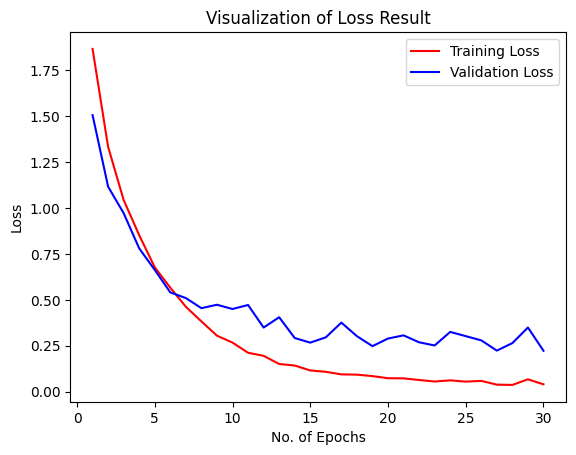

In [37]:
#Visualization of Loss
epochs = [i for i in range(1,31)]
plt.plot(epochs,training_history_data['loss'],label="Training Loss",color='red')
plt.plot(epochs,training_history_data['val_loss'],label="Validation Loss",color='blue')
plt.xlabel("No. of Epochs")
plt.ylabel("Loss")
plt.title("Visualization of Loss Result")
plt.legend()
plt.show()

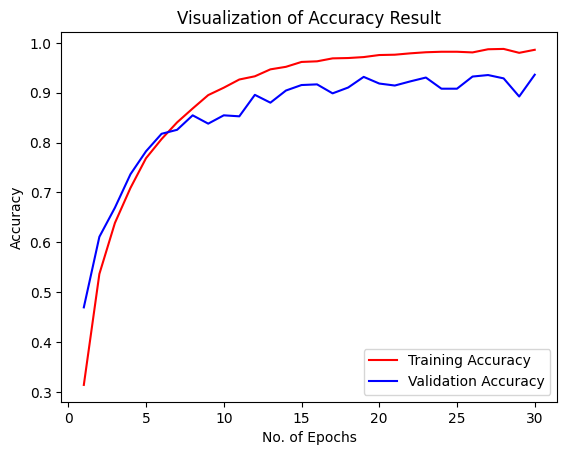

In [38]:
#Visualization of Accuracy
epochs = [i for i in range(1,31)]
plt.plot(epochs,training_history_data['accuracy'],label="Training Accuracy",color='red')
plt.plot(epochs,training_history_data['val_accuracy'],label="Validation Accuracy",color='blue')
plt.xlabel("No. of Epochs")
plt.ylabel("Accuracy")
plt.title("Visualization of Accuracy Result")
plt.legend()
plt.show()

# model evaluation-II

In [40]:
X_test.shape

(2995, 210, 210, 1)

In [41]:
y_pred = model.predict(X_test)

94/94 ━━━━━━━━━━━━━━━━━━━━ 4s 40ms/step


In [42]:
y_pred

array([[1.82758661e-16, 4.09177685e-19, 1.07260256e-14, ...,
        1.00000000e+00, 7.20370341e-09, 3.90307918e-17],
       [8.68849784e-11, 8.42018122e-12, 2.41893977e-10, ...,
        3.40010971e-11, 4.39401770e-13, 8.92497425e-04],
       [4.67458158e-13, 2.07109950e-13, 6.48248003e-13, ...,
        1.89349643e-12, 5.67552353e-13, 3.69201075e-07],
       ...,
       [9.88778323e-02, 1.18548638e-09, 9.00973678e-01, ...,
        7.34052010e-05, 8.14616385e-07, 1.00376356e-08],
       [1.21344194e-04, 9.93502438e-01, 7.69403414e-05, ...,
        5.92643744e-04, 7.14239606e-04, 8.43597576e-04],
       [3.25859592e-13, 2.74383533e-24, 3.65774371e-26, ...,
        9.02421263e-11, 2.67753064e-09, 9.99341262e-14]], dtype=float32)

In [43]:
y_pred.shape


(2995, 10)

In [44]:
predicted_categories = np.argmax(y_pred,axis=1)
predicted_categories

array([7, 6, 6, ..., 2, 1, 4])

In [45]:
Y_test


array([[0., 0., 0., ..., 1., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [1., 0., 0., ..., 0., 0., 0.],
       [0., 1., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [46]:
Y_test.shape


(2995, 10)

In [47]:
true_categories = np.argmax(Y_test,axis=1)
true_categories

array([7, 6, 6, ..., 0, 1, 4])

In [48]:
classes

['blues',
 'classical',
 'country',
 'disco',
 'hiphop',
 'jazz',
 'metal',
 'pop',
 'reggae',
 'rock']

In [49]:
from sklearn.metrics import confusion_matrix,classification_report
cm = confusion_matrix(true_categories,predicted_categories)
# Precision Recall F1score
print(classification_report(true_categories,predicted_categories,target_names=classes))

              precision    recall  f1-score   support

       blues       0.94      0.95      0.94       302
   classical       0.91      0.99      0.95       298
     country       0.90      0.90      0.90       317
       disco       0.94      0.94      0.94       312
      hiphop       0.99      0.93      0.96       277
        jazz       0.96      0.95      0.95       311
       metal       0.99      0.97      0.98       302
         pop       0.92      0.93      0.93       289
      reggae       0.92      0.96      0.94       296
        rock       0.91      0.84      0.87       291

    accuracy                           0.94      2995
   macro avg       0.94      0.94      0.94      2995
weighted avg       0.94      0.94      0.94      2995



In [50]:
cm

array([[288,   1,   6,   0,   0,   2,   0,   0,   4,   1],
       [  0, 296,   0,   0,   0,   2,   0,   0,   0,   0],
       [  7,   5, 285,   5,   0,   6,   0,   4,   3,   2],
       [  0,   3,   1, 292,   0,   0,   0,   4,   7,   5],
       [  1,   1,   0,   2, 258,   0,   2,   5,   6,   2],
       [  0,  12,   0,   1,   0, 295,   0,   0,   1,   2],
       [  0,   0,   2,   0,   2,   1, 292,   0,   0,   5],
       [  1,   3,   3,   4,   0,   1,   0, 270,   2,   5],
       [  4,   1,   0,   0,   1,   0,   0,   4, 285,   1],
       [  7,   3,  19,   7,   0,   1,   2,   6,   3, 243]])

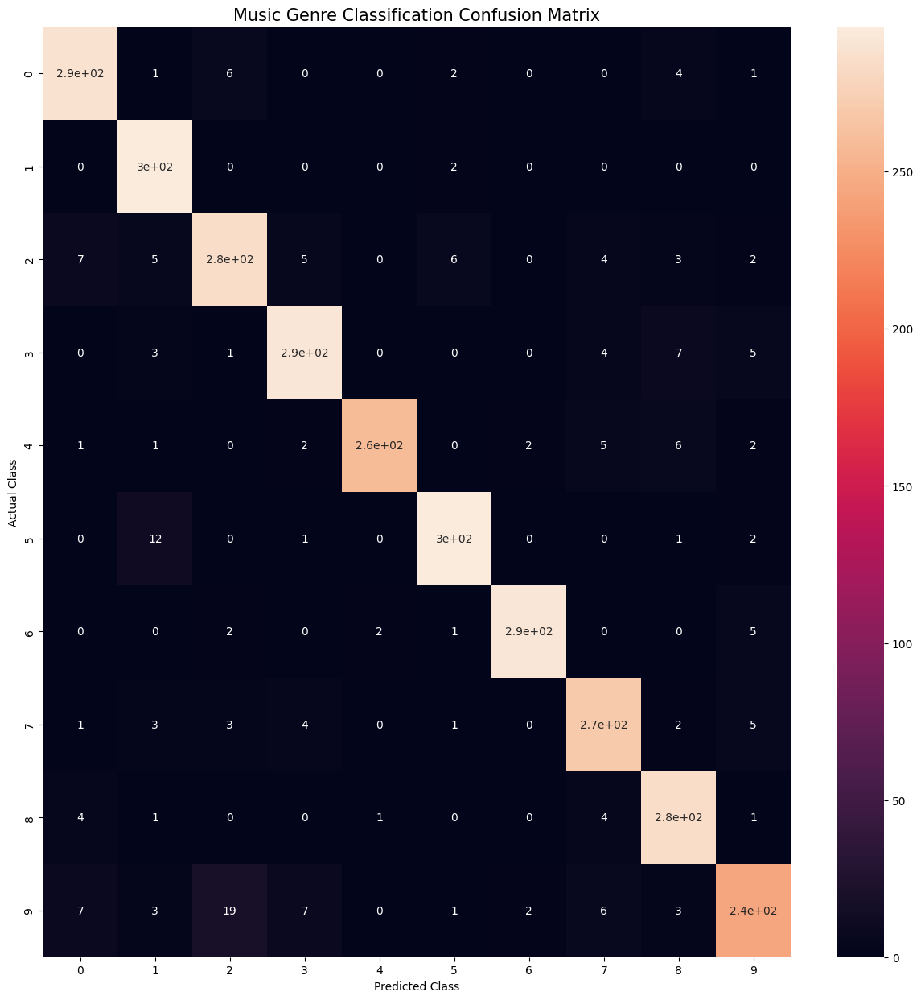

In [51]:
import seaborn as sns
plt.figure(figsize=(15,15))
sns.heatmap(cm,annot=True,annot_kws={"size":10})
plt.xlabel("Predicted Class",fontsize=10)
plt.ylabel("Actual Class",fontsize=10)
plt.title("Music Genre Classification Confusion Matrix",fontsize=15)
plt.show()


# Testing

In [55]:
import os
import librosa
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.image import resize

In [56]:
#Loading Model
model = tf.keras.models.load_model("/content/drive/MyDrive/deep_audio_classification/Trained_model.keras")

In [53]:
classes = ['blues', 'classical','country','disco','hiphop','jazz','metal','pop','reggae','rock']

In [57]:
# Load and preprocess audio data
def load_and_preprocess_file(file_path, target_shape=(210, 210)):
    data = []
    audio_data, sample_rate = librosa.load(file_path, sr=None)
    # Perform preprocessing (e.g., convert to Mel spectrogram and resize)
    # Define the duration of each chunk and overlap
    chunk_duration = 4  # seconds
    overlap_duration = 2  # seconds

    # Convert durations to samples
    chunk_samples = chunk_duration * sample_rate
    overlap_samples = overlap_duration * sample_rate

    # Calculate the number of chunks
    num_chunks = int(np.ceil((len(audio_data) - chunk_samples) / (chunk_samples - overlap_samples))) + 1

    # Iterate over each chunk
    for i in range(num_chunks):
                    # Calculate start and end indices of the chunk
        start = i * (chunk_samples - overlap_samples)
        end = start + chunk_samples

                    # Extract the chunk of audio
        chunk = audio_data[start:end]

                    # Compute the Mel spectrogram for the chunk
        mel_spectrogram = librosa.feature.melspectrogram(y=chunk, sr=sample_rate)

                #mel_spectrogram = librosa.feature.melspectrogram(y=audio_data, sr=sample_rate)
        mel_spectrogram = resize(np.expand_dims(mel_spectrogram, axis=-1), target_shape)
        data.append(mel_spectrogram)

    return np.array(data)

In [99]:
from IPython.display import Audio
file_path2 = "/content/drive/MyDrive/deep_audio_classification/Test_Music/move-forward-hip-hop-165711.mp3"
y, sr = librosa.load(file_path2, sr=44100)
Audio(data=y, rate=sr)

In [107]:
file_path2="/content/drive/MyDrive/deep_audio_classification/Test_Music/move-forward-hip-hop-165711.mp3"
X_test2= load_and_preprocess_file(file_path2)

In [109]:
X_test2

array([[[[3.34383060e-07],
         [6.62957027e-05],
         [3.08343978e-03],
         ...,
         [6.70633279e-03],
         [1.09724775e-02],
         [8.24465510e-03]],

        [[3.37242454e-07],
         [1.17261479e-04],
         [8.80870409e-03],
         ...,
         [5.96105447e-03],
         [1.01006227e-02],
         [5.84983081e-03]],

        [[3.83448764e-07],
         [1.91049650e-04],
         [1.69543363e-02],
         ...,
         [4.81982715e-03],
         [8.67654942e-03],
         [2.46487185e-03]],

        ...,

        [[1.83738652e-16],
         [1.21990295e-14],
         [7.70676586e-14],
         ...,
         [1.62830838e-12],
         [1.88592350e-10],
         [1.47787745e-07]],

        [[2.67347712e-16],
         [1.35902184e-14],
         [5.45580528e-14],
         ...,
         [2.35584924e-12],
         [1.87832541e-10],
         [1.46844556e-07]],

        [[3.26094397e-16],
         [1.45506606e-14],
         [3.80222824e-14],
         ...,
 

In [110]:
X_test2.shape

(44, 210, 210, 1)

model prediction

In [108]:
def model_prediction(X_test2):
  y_pred2= model.predict(X_test2)
  predicted_categories2=np.argmax(y_pred2, axis=1)
  unique_elements, counts = np.unique(predicted_categories2,return_counts=True)
  max_count= np.max(counts)
  max_elements = unique_elements[counts==max_count]
  return max_elements[0]

In [112]:
c_index = model_prediction(X_test2)

2/2 ━━━━━━━━━━━━━━━━━━━━ 0s 408ms/step


In [113]:
c_index

np.int64(4)

In [114]:
print("model prediction: music genre --->",classes[c_index])

model prediction: music genre ---> hiphop
